# Visium data - QC and prep for cell2location

In [1]:
import os,sys        
import scanpy as sc
import squidpy as sq
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib as mpl

import scvi

from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
import seaborn as sns

import torch

Global seed set to 0


In [2]:
org_colors = pd.read_csv('../../../metadata/organ_colors.csv')

In [3]:

# Define a context manager to suppress stdout and stderr.
class suppress_stdout_stderr(object):
    '''
    A context manager for doing a "deep suppression" of stdout and stderr in 
    Python, i.e. will suppress all print, even if the print originates in a 
    compiled C/Fortran sub-function.
       This will not suppress raised exceptions, since exceptions are printed
    to stderr just before a script exits, and after the context manager has
    exited (at least, I think that is why it lets exceptions through).      

    '''
    def __init__(self):
        # Open a pair of null files
        self.null_fds =  [os.open(os.devnull,os.O_RDWR) for x in range(2)]
        # Save the actual stdout (1) and stderr (2) file descriptors.
        self.save_fds = [os.dup(1), os.dup(2)]

    def __enter__(self):
        # Assign the null pointers to stdout and stderr.
        os.dup2(self.null_fds[0],1)
        os.dup2(self.null_fds[1],2)

    def __exit__(self, *_):
        # Re-assign the real stdout/stderr back to (1) and (2)
        os.dup2(self.save_fds[0],1)
        os.dup2(self.save_fds[1],2)
        # Close all file descriptors
        for fd in self.null_fds + self.save_fds:
            os.close(fd)

In [4]:
## r2py setup
import rpy2.rinterface_lib.callbacks
import logging
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

In [5]:
figdir = "/home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/Visium_QC_batch2/"
if not os.path.exists(figdir):
    os.mkdir(figdir)
sc.settings.figdir = figdir


In [6]:
%load_ext rpy2.ipython

In [7]:
%%R
library(tidyverse)
library(reshape2)
library(patchwork)

remove_x_axis <- function(){
  theme(axis.text.x = element_blank(), axis.ticks.x = element_blank(), axis.title.x = element_blank())  
}

remove_y_axis <- function(){
  theme(axis.text.y = element_blank(), axis.ticks.y = element_blank(), axis.title.y = element_blank())  
}

## 1. Loading Visium data <a name="1.-Loading-Visium-data"></a>

First, we need to download and unzip spatial data, as well as download estimated signatures of reference cell types:

In [8]:
sp_data_folder = '/nfs/team205/ed6/data/Fetal_immune/spaceranger/'

Now, let's read the spatial Visium data from the 10X Space Ranger output and examine several QC plots. Here, we load the our Visium mouse brain experiments (i.e. sections) and corresponding histology images into a single anndata object `adata`.

In [11]:
def read_and_qc(sample_name, path=sp_data_folder + 'rawdata/'):
    r""" This function reads the data for one 10X spatial experiment into the anndata object.
    It also calculates QC metrics. Modify this function if required by your workflow.
    
    :param sample_name: Name of the sample
    :param path: path to data
    """
    
    adata = sc.read_visium(path + str(sample_name),
                           count_file='raw_feature_bc_matrix.h5', load_images=True)
    print('0' + sample_name)
    adata.obs['sample'] = sample_name
    adata.var['SYMBOL'] = adata.var_names
    adata.var.rename(columns={'gene_ids': 'ENSEMBL'}, inplace=True)
    adata.var_names = adata.var['ENSEMBL']
    adata.var.drop(columns='ENSEMBL', inplace=True)

    # Calculate QC metrics
    from scipy.sparse import csr_matrix
    adata.X = csr_matrix(adata.X)
    sc.pp.calculate_qc_metrics(adata, inplace=True)
    print('1' + sample_name)
    adata.var['mt'] = [gene.startswith('mt-') for gene in adata.var['SYMBOL']]
    adata.obs['mt_frac'] = np.array(adata[:, adata.var['mt'].tolist()].X.sum(1)).flatten()/adata.obs['total_counts']
    print('2' + sample_name)

    # add sample name to obs names
    adata.obs["sample"] = [str(i) for i in adata.obs['sample']]
    adata.obs_names = adata.obs["sample"] \
                          + '_' + adata.obs_names
    adata.obs.index.name = 'spot_id'
    print('3' + sample_name)
    
    return adata

def select_slide(adata, s, s_col='sample', select_spatial=True):
    r""" This function selects the data for one slide from the spatial anndata object.
    
    :param adata: Anndata object with multiple spatial experiments
    :param s: name of selected experiment
    :param s_col: column in adata.obs listing experiment name for each location
    """
    
    slide = adata[adata.obs[s_col].isin([s]), :].copy()
    if select_spatial:
        s_keys = list(slide.uns['spatial'].keys())
        s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

        slide.uns['spatial'] = {s_spatial: slide.uns['spatial'][s_spatial]}
    return slide

In [9]:
#######################
# Read the list of spatial experiments
sample_data = pd.read_csv('/home/jovyan/mount/gdrive/Pan_fetal/meta_share/panfetal_visium_metadata_v2.csv')

# Match metadata and file paths
from glob import glob
def find(lst, sample):
    return [i for i, x in enumerate(lst) if sample in x]
paths = glob(f'{sp_data_folder}*')
for i in sample_data.index:
    ind = find(paths, sample_data.loc[i, 'Sanger_ID'])
    if len(ind) == 1:
        sample_data.loc[i, 'paths'] = paths[ind[0]]

In [10]:
# sample_data = sample_data.drop(['Data_dir', 'file'],1).copy()
sample_data.to_csv("../../../metadata/panfetal_visium_metadata_v2.csv")

In [102]:
sample_data = pd.read_csv("../../../metadata/panfetal_visium_metadata_v2.csv")

sample_data = sample_data.loc[~sample_data['paths'].isna(), :]
sample_data['paths'] = sample_data['paths'].astype(str)
sample_data['sample_id'] = [os.path.basename(p) for p in sample_data['paths']]

sample_data.index = sample_data.Sanger_ID.values.copy()

In [26]:
# Read the data into anndata objects
slides = []
for i in sample_data['sample_id'].values:
    slides.append(read_and_qc(i, path=sp_data_folder))

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A
1spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A
2spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A
3spaceranger130_count_36654_WSSS_F_IMMsp9838712_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36654_WSSS_F_IMMsp9838709_GRCh38-2020-A
1spaceranger130_count_36654_WSSS_F_IMMsp9838709_GRCh38-2020-A
2spaceranger130_count_36654_WSSS_F_IMMsp9838709_GRCh38-2020-A
3spaceranger130_count_36654_WSSS_F_IMMsp9838709_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36654_WSSS_F_IMMsp9838710_GRCh38-2020-A
1spaceranger130_count_36654_WSSS_F_IMMsp9838710_GRCh38-2020-A
2spaceranger130_count_36654_WSSS_F_IMMsp9838710_GRCh38-2020-A
3spaceranger130_count_36654_WSSS_F_IMMsp9838710_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36654_WSSS_F_IMMsp9838711_GRCh38-2020-A
1spaceranger130_count_36654_WSSS_F_IMMsp9838711_GRCh38-2020-A
2spaceranger130_count_36654_WSSS_F_IMMsp9838711_GRCh38-2020-A
3spaceranger130_count_36654_WSSS_F_IMMsp9838711_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36811_WSSS_F_IMMsp9838717_GRCh38-2020-A
1spaceranger130_count_36811_WSSS_F_IMMsp9838717_GRCh38-2020-A
2spaceranger130_count_36811_WSSS_F_IMMsp9838717_GRCh38-2020-A
3spaceranger130_count_36811_WSSS_F_IMMsp9838717_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36811_WSSS_F_IMMsp9838714_GRCh38-2020-A
1spaceranger130_count_36811_WSSS_F_IMMsp9838714_GRCh38-2020-A
2spaceranger130_count_36811_WSSS_F_IMMsp9838714_GRCh38-2020-A
3spaceranger130_count_36811_WSSS_F_IMMsp9838714_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36811_WSSS_F_IMMsp9838715_GRCh38-2020-A
1spaceranger130_count_36811_WSSS_F_IMMsp9838715_GRCh38-2020-A
2spaceranger130_count_36811_WSSS_F_IMMsp9838715_GRCh38-2020-A
3spaceranger130_count_36811_WSSS_F_IMMsp9838715_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_36811_WSSS_F_IMMsp9838716_GRCh38-2020-A
1spaceranger130_count_36811_WSSS_F_IMMsp9838716_GRCh38-2020-A
2spaceranger130_count_36811_WSSS_F_IMMsp9838716_GRCh38-2020-A
3spaceranger130_count_36811_WSSS_F_IMMsp9838716_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0WSSS_F_IMMsp10864180
1WSSS_F_IMMsp10864180
2WSSS_F_IMMsp10864180
3WSSS_F_IMMsp10864180


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_WSSS_F_IMMsp10864178_GRCh38-2020-A
1spaceranger130_count_WSSS_F_IMMsp10864178_GRCh38-2020-A
2spaceranger130_count_WSSS_F_IMMsp10864178_GRCh38-2020-A
3spaceranger130_count_WSSS_F_IMMsp10864178_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0WSSS_F_IMMsp10864177
1WSSS_F_IMMsp10864177
2WSSS_F_IMMsp10864177
3WSSS_F_IMMsp10864177


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_WSSS_F_IMMsp10864184_GRCh38-2020-A
1spaceranger130_count_WSSS_F_IMMsp10864184_GRCh38-2020-A
2spaceranger130_count_WSSS_F_IMMsp10864184_GRCh38-2020-A
3spaceranger130_count_WSSS_F_IMMsp10864184_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0WSSS_F_IMMsp10864181
1WSSS_F_IMMsp10864181
2WSSS_F_IMMsp10864181
3WSSS_F_IMMsp10864181


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0WSSS_F_IMMsp10864182
1WSSS_F_IMMsp10864182
2WSSS_F_IMMsp10864182
3WSSS_F_IMMsp10864182


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_WSSS_F_IMMsp10864183_GRCh38-2020-A
1spaceranger130_count_WSSS_F_IMMsp10864183_GRCh38-2020-A
2spaceranger130_count_WSSS_F_IMMsp10864183_GRCh38-2020-A
3spaceranger130_count_WSSS_F_IMMsp10864183_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42704_WSSS_F_IMMsp11604681_GRCh38-2020-A
1spaceranger130_count_42704_WSSS_F_IMMsp11604681_GRCh38-2020-A
2spaceranger130_count_42704_WSSS_F_IMMsp11604681_GRCh38-2020-A
3spaceranger130_count_42704_WSSS_F_IMMsp11604681_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42704_WSSS_F_IMMsp11604682_GRCh38-2020-A
1spaceranger130_count_42704_WSSS_F_IMMsp11604682_GRCh38-2020-A
2spaceranger130_count_42704_WSSS_F_IMMsp11604682_GRCh38-2020-A
3spaceranger130_count_42704_WSSS_F_IMMsp11604682_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42704_WSSS_F_IMMsp11604683_GRCh38-2020-A
1spaceranger130_count_42704_WSSS_F_IMMsp11604683_GRCh38-2020-A
2spaceranger130_count_42704_WSSS_F_IMMsp11604683_GRCh38-2020-A
3spaceranger130_count_42704_WSSS_F_IMMsp11604683_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42704_WSSS_F_IMMsp11604684_GRCh38-2020-A
1spaceranger130_count_42704_WSSS_F_IMMsp11604684_GRCh38-2020-A
2spaceranger130_count_42704_WSSS_F_IMMsp11604684_GRCh38-2020-A
3spaceranger130_count_42704_WSSS_F_IMMsp11604684_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42702_WSSS_F_IMMsp11604685_GRCh38-2020-A
1spaceranger130_count_42702_WSSS_F_IMMsp11604685_GRCh38-2020-A
2spaceranger130_count_42702_WSSS_F_IMMsp11604685_GRCh38-2020-A
3spaceranger130_count_42702_WSSS_F_IMMsp11604685_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42702_WSSS_F_IMMsp11604686_GRCh38-2020-A
1spaceranger130_count_42702_WSSS_F_IMMsp11604686_GRCh38-2020-A
2spaceranger130_count_42702_WSSS_F_IMMsp11604686_GRCh38-2020-A
3spaceranger130_count_42702_WSSS_F_IMMsp11604686_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42702_WSSS_F_IMMsp11604687_GRCh38-2020-A
1spaceranger130_count_42702_WSSS_F_IMMsp11604687_GRCh38-2020-A
2spaceranger130_count_42702_WSSS_F_IMMsp11604687_GRCh38-2020-A
3spaceranger130_count_42702_WSSS_F_IMMsp11604687_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0WSSS_F_IMMsp11604688
1WSSS_F_IMMsp11604688
2WSSS_F_IMMsp11604688
3WSSS_F_IMMsp11604688


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42727_WSSS_F_IMMsp11604689_GRCh38-2020-A
1spaceranger130_count_42727_WSSS_F_IMMsp11604689_GRCh38-2020-A
2spaceranger130_count_42727_WSSS_F_IMMsp11604689_GRCh38-2020-A
3spaceranger130_count_42727_WSSS_F_IMMsp11604689_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42727_WSSS_F_IMMsp11604690_GRCh38-2020-A
1spaceranger130_count_42727_WSSS_F_IMMsp11604690_GRCh38-2020-A
2spaceranger130_count_42727_WSSS_F_IMMsp11604690_GRCh38-2020-A
3spaceranger130_count_42727_WSSS_F_IMMsp11604690_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42727_WSSS_F_IMMsp11604691_GRCh38-2020-A
1spaceranger130_count_42727_WSSS_F_IMMsp11604691_GRCh38-2020-A
2spaceranger130_count_42727_WSSS_F_IMMsp11604691_GRCh38-2020-A
3spaceranger130_count_42727_WSSS_F_IMMsp11604691_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0WSSS_F_IMMsp11604692
1WSSS_F_IMMsp11604692
2WSSS_F_IMMsp11604692
3WSSS_F_IMMsp11604692


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42728_WSSS_F_IMMsp11604693_GRCh38-2020-A
1spaceranger130_count_42728_WSSS_F_IMMsp11604693_GRCh38-2020-A
2spaceranger130_count_42728_WSSS_F_IMMsp11604693_GRCh38-2020-A
3spaceranger130_count_42728_WSSS_F_IMMsp11604693_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42728_WSSS_F_IMMsp11604694_GRCh38-2020-A
1spaceranger130_count_42728_WSSS_F_IMMsp11604694_GRCh38-2020-A
2spaceranger130_count_42728_WSSS_F_IMMsp11604694_GRCh38-2020-A
3spaceranger130_count_42728_WSSS_F_IMMsp11604694_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42728_WSSS_F_IMMsp11604695_GRCh38-2020-A
1spaceranger130_count_42728_WSSS_F_IMMsp11604695_GRCh38-2020-A
2spaceranger130_count_42728_WSSS_F_IMMsp11604695_GRCh38-2020-A
3spaceranger130_count_42728_WSSS_F_IMMsp11604695_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_42728_WSSS_F_IMMsp11604696_GRCh38-2020-A
1spaceranger130_count_42728_WSSS_F_IMMsp11604696_GRCh38-2020-A
2spaceranger130_count_42728_WSSS_F_IMMsp11604696_GRCh38-2020-A
3spaceranger130_count_42728_WSSS_F_IMMsp11604696_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_43084_WSSS_F_IMMsp11765867_GRCh38-2020-A
1spaceranger130_count_43084_WSSS_F_IMMsp11765867_GRCh38-2020-A
2spaceranger130_count_43084_WSSS_F_IMMsp11765867_GRCh38-2020-A
3spaceranger130_count_43084_WSSS_F_IMMsp11765867_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_43084_WSSS_F_IMMsp11765868_GRCh38-2020-A
1spaceranger130_count_43084_WSSS_F_IMMsp11765868_GRCh38-2020-A
2spaceranger130_count_43084_WSSS_F_IMMsp11765868_GRCh38-2020-A
3spaceranger130_count_43084_WSSS_F_IMMsp11765868_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_43084_WSSS_F_IMMsp11765869_GRCh38-2020-A
1spaceranger130_count_43084_WSSS_F_IMMsp11765869_GRCh38-2020-A
2spaceranger130_count_43084_WSSS_F_IMMsp11765869_GRCh38-2020-A
3spaceranger130_count_43084_WSSS_F_IMMsp11765869_GRCh38-2020-A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0spaceranger130_count_43084_WSSS_F_IMMsp11765870_GRCh38-2020-A
1spaceranger130_count_43084_WSSS_F_IMMsp11765870_GRCh38-2020-A
2spaceranger130_count_43084_WSSS_F_IMMsp11765870_GRCh38-2020-A
3spaceranger130_count_43084_WSSS_F_IMMsp11765870_GRCh38-2020-A


... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


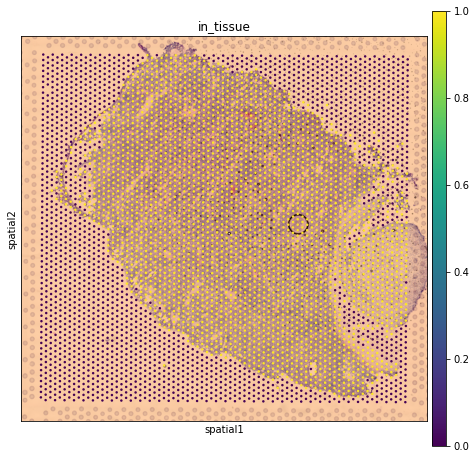

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


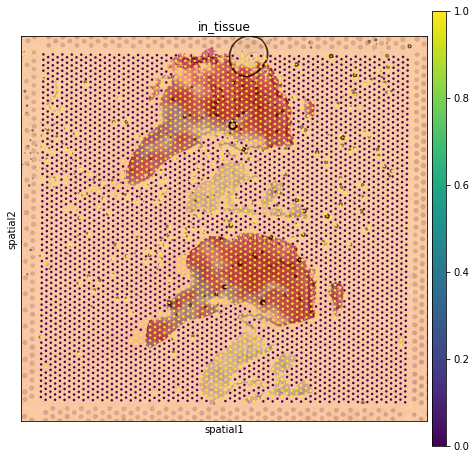

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


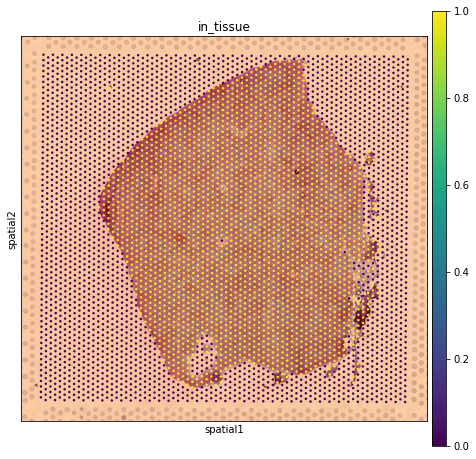

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


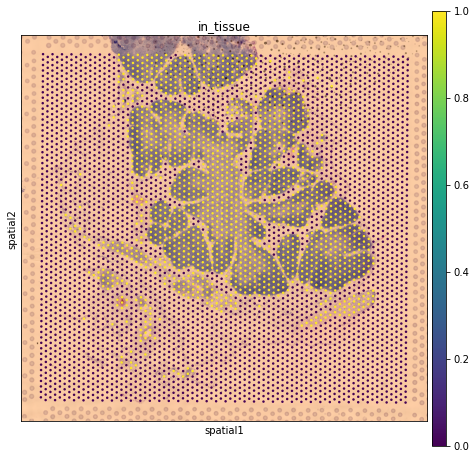

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


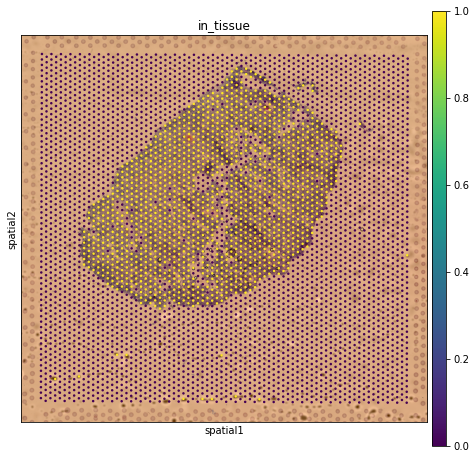

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


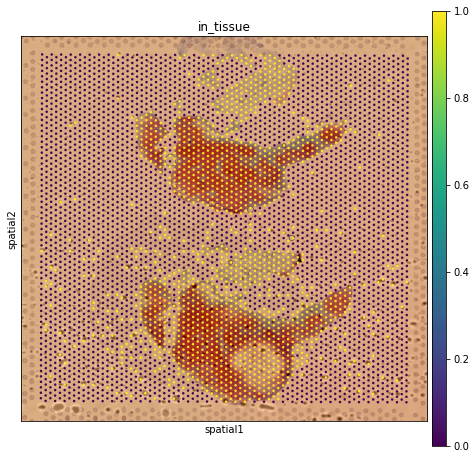

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


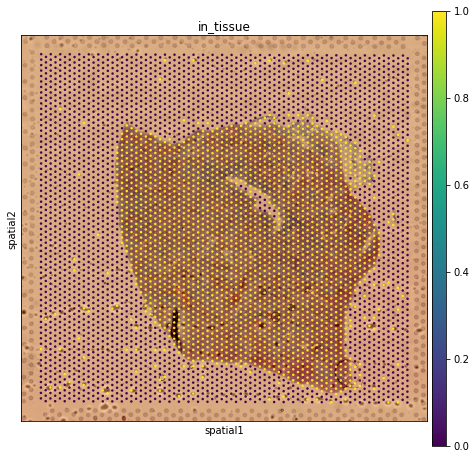

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


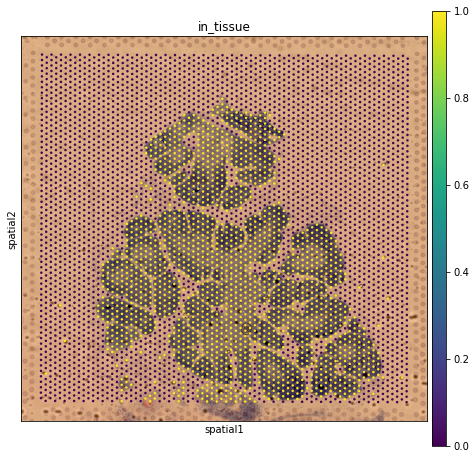

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


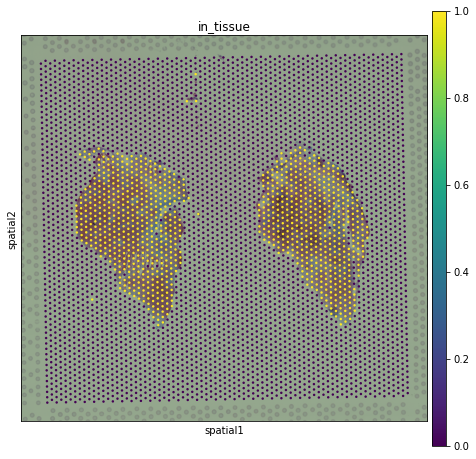

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


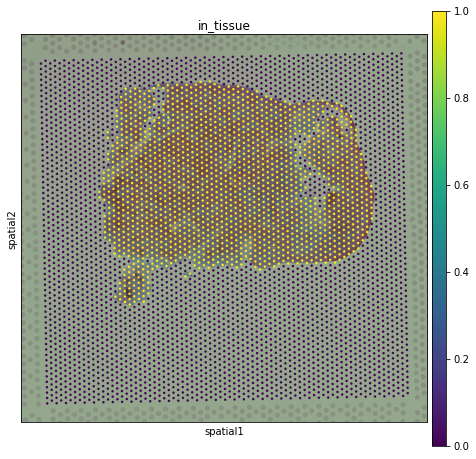

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


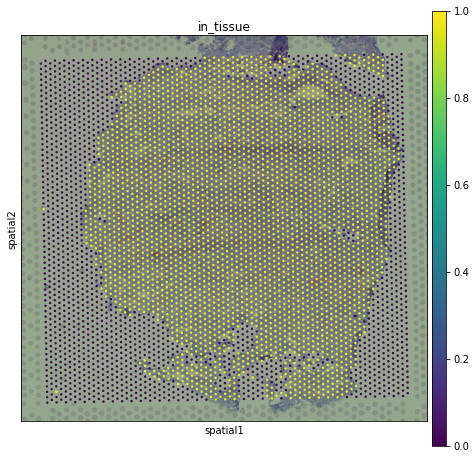

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


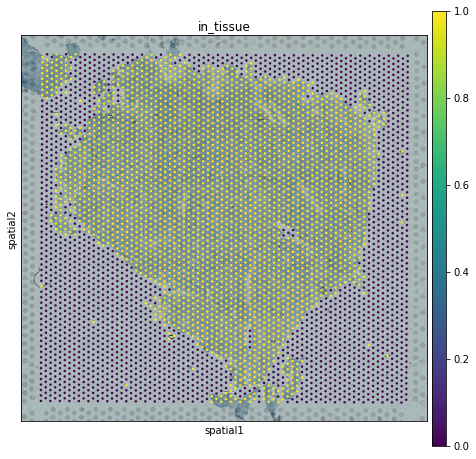

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


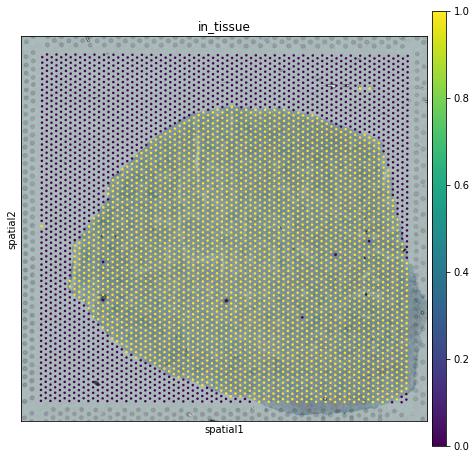

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


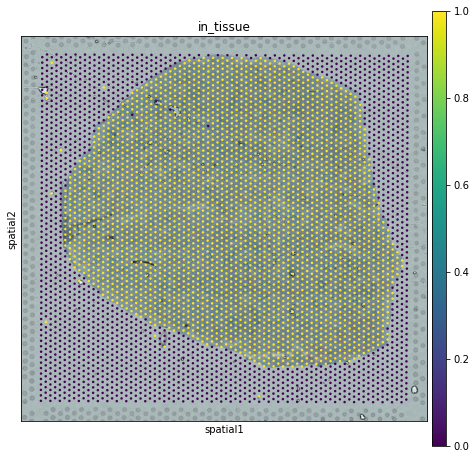

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


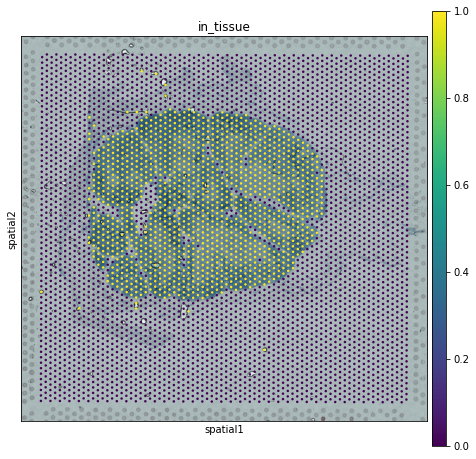

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


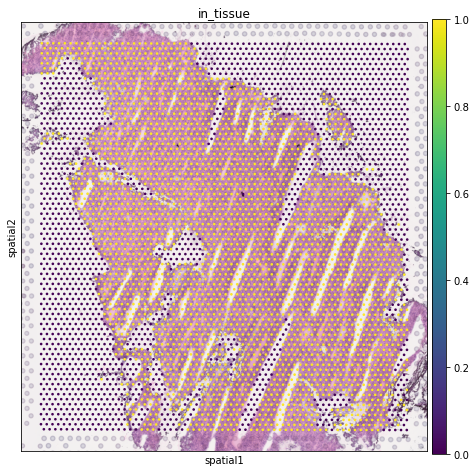

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


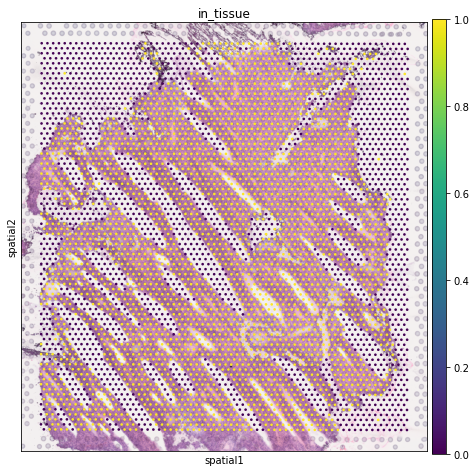

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


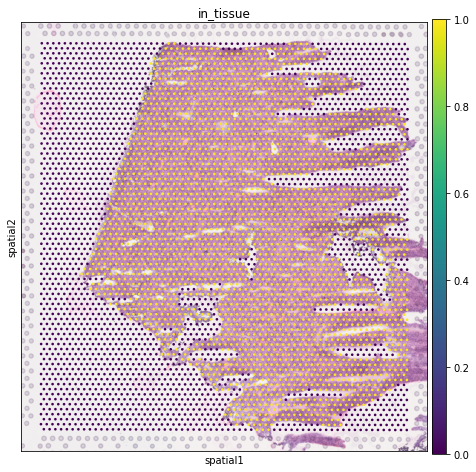

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


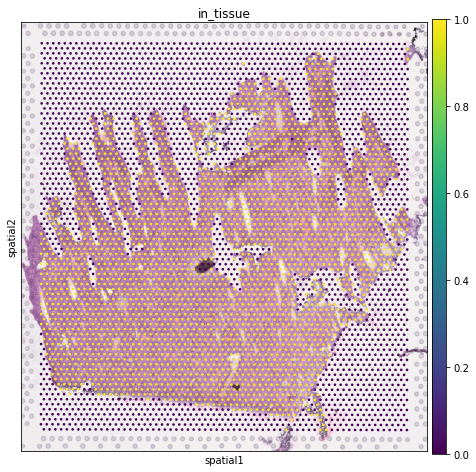

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


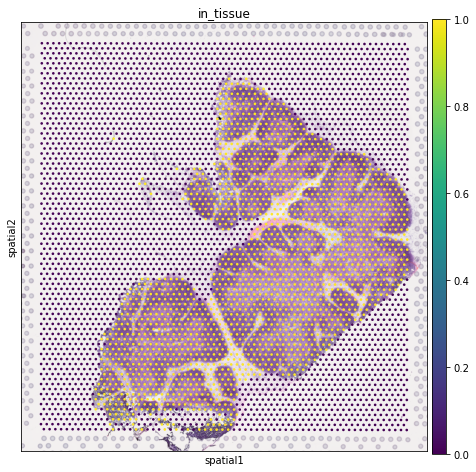

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


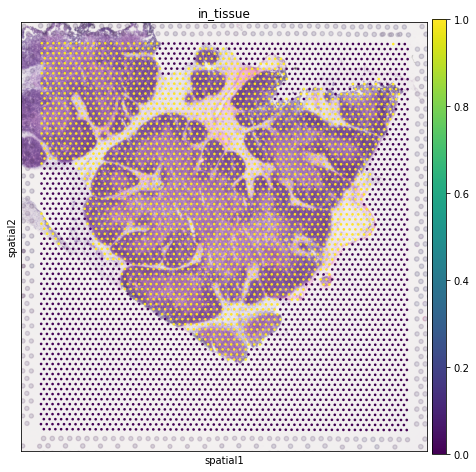

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


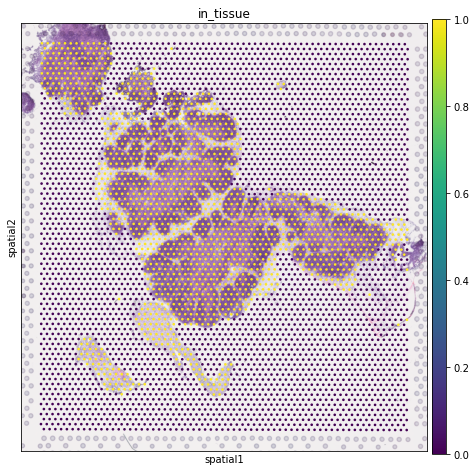

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


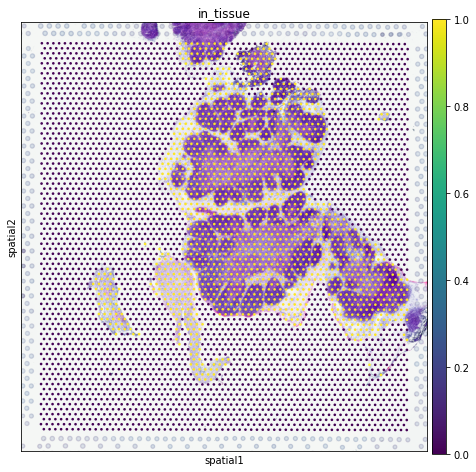

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


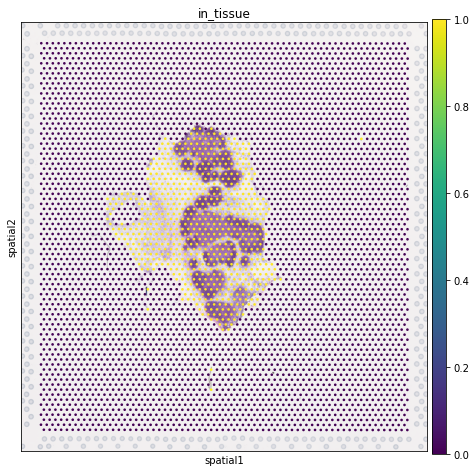

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


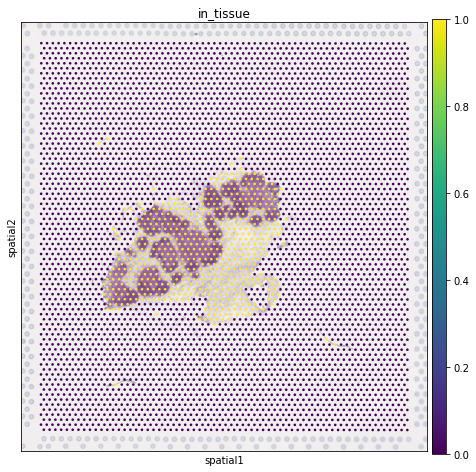

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


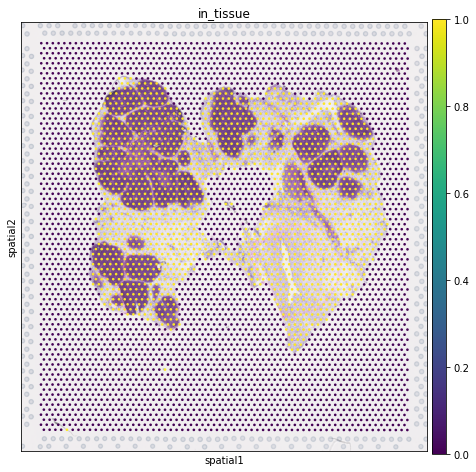

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


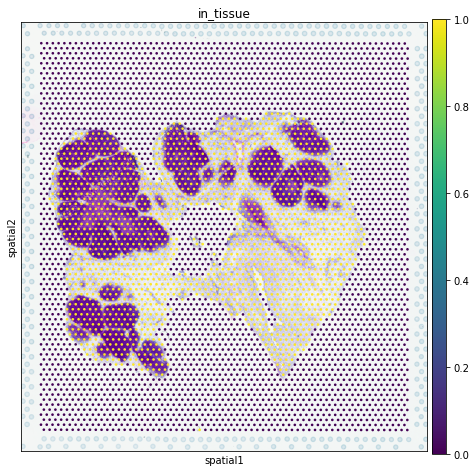

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


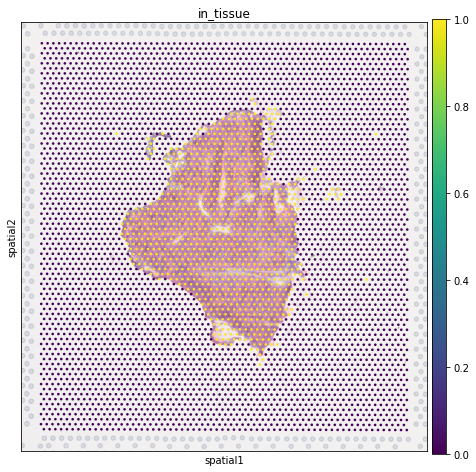

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


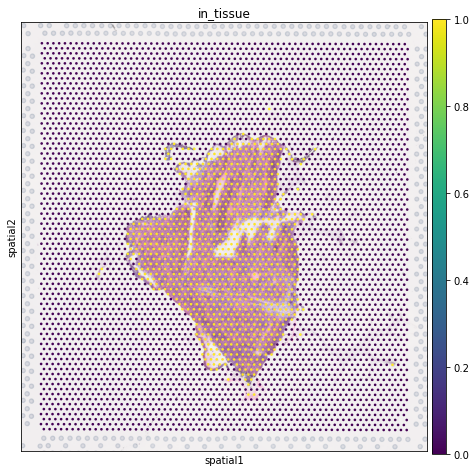

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


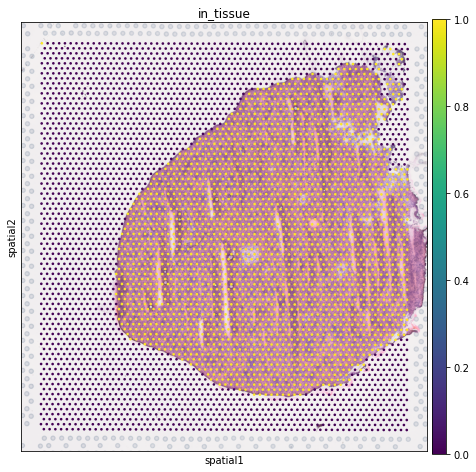

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


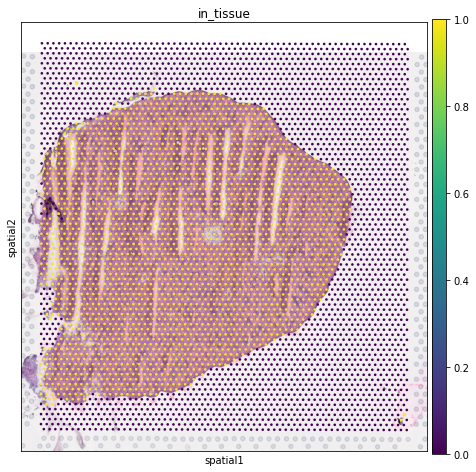

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


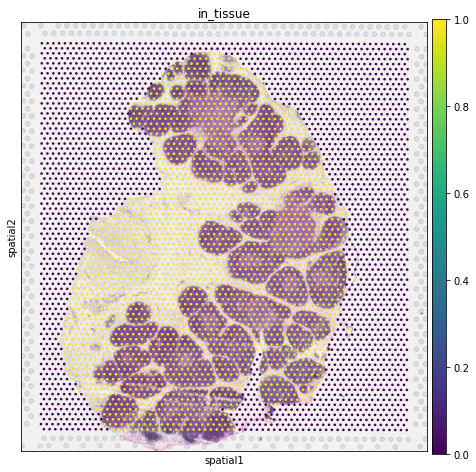

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


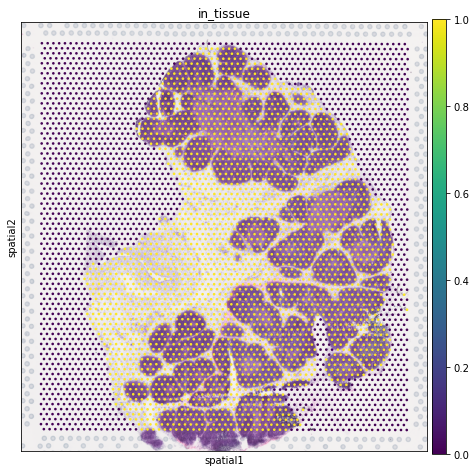

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


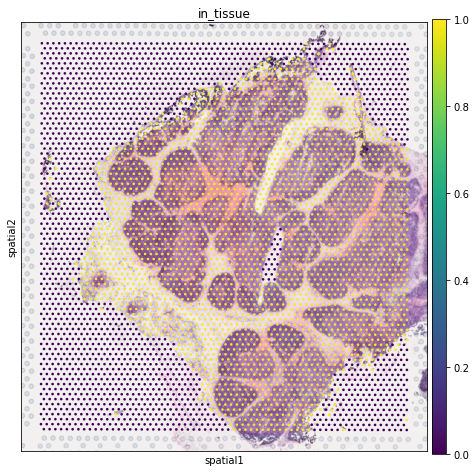

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


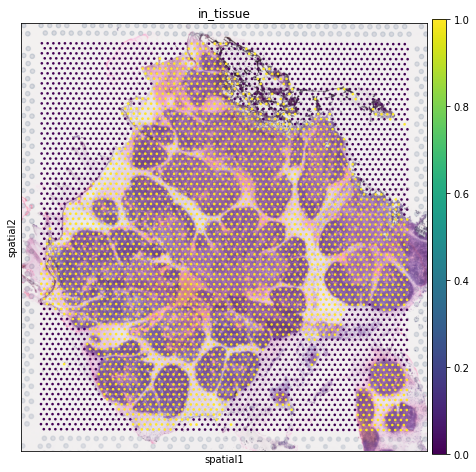

In [27]:
plt.rcParams['figure.figsize'] = (8,8)
for s in slides:
#     s.obs['is_tissue'] = s.obs['in_tissue'].copy()
    sc.pl.spatial(s, color='in_tissue', size=0.7)
#     s.obs['in_tissue'] = s.obs['is_tissue'].copy()

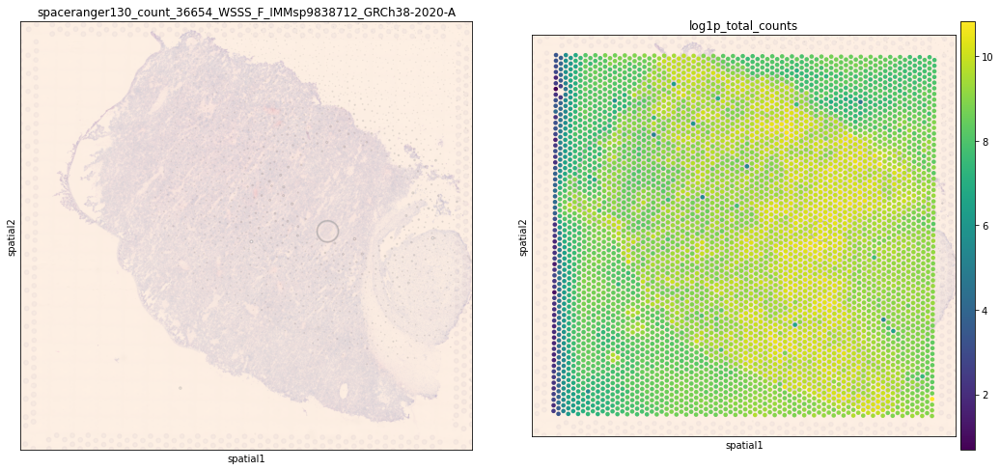

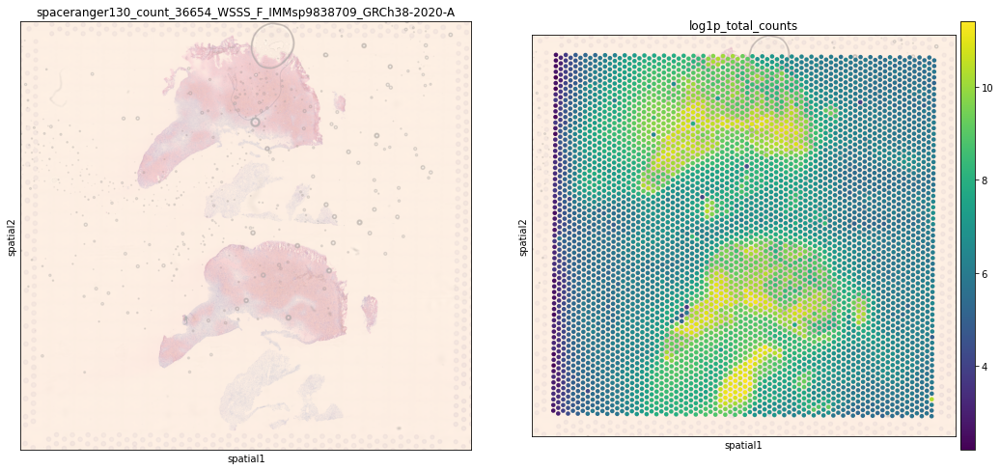

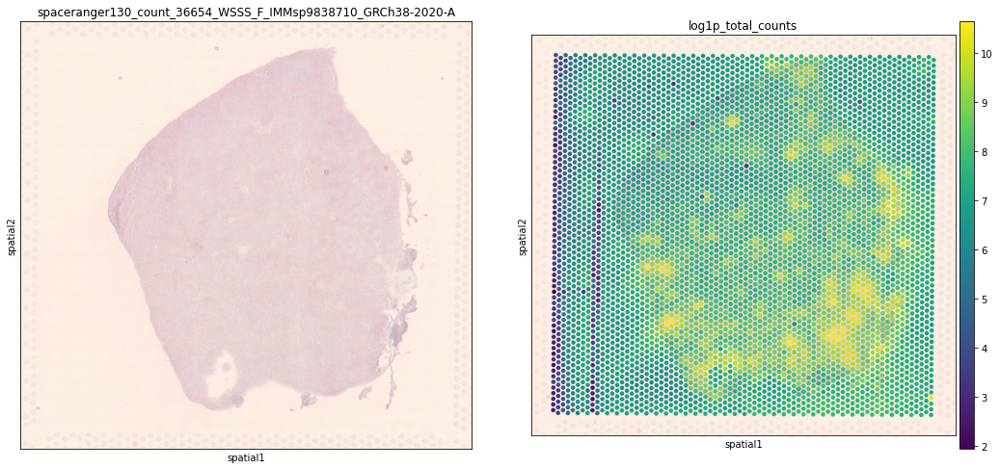

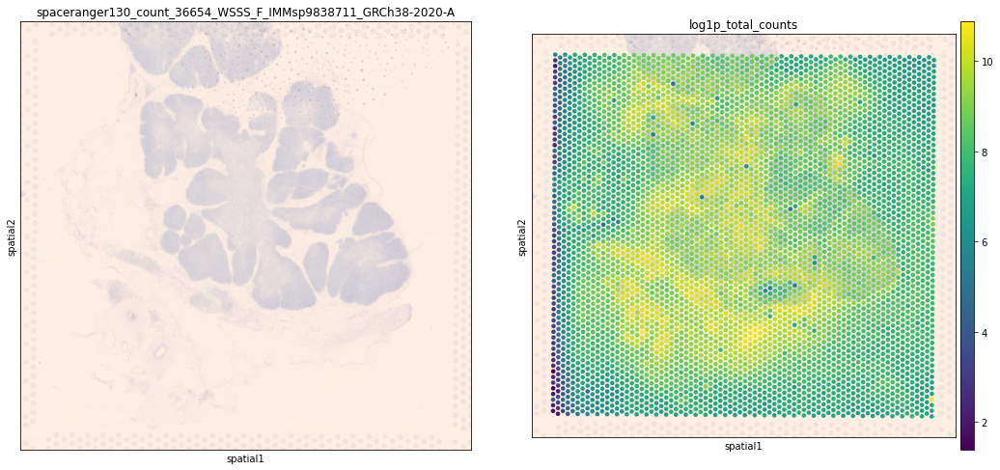

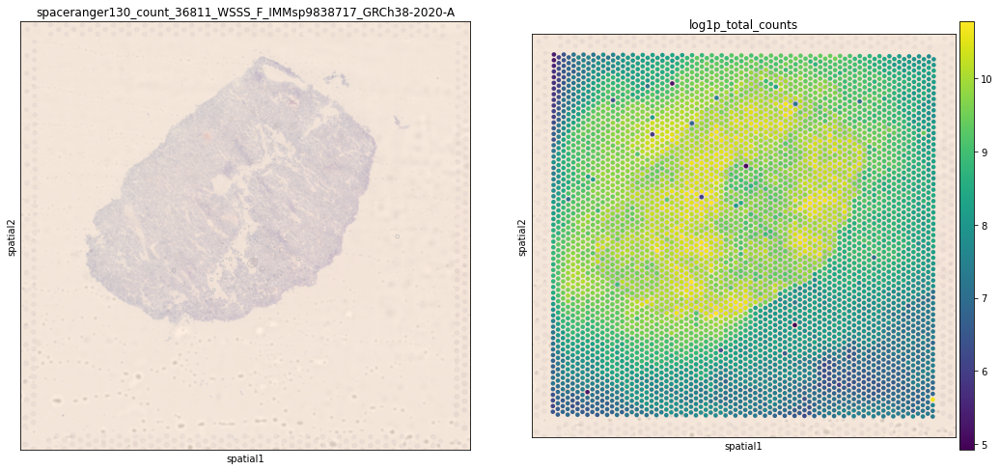

...

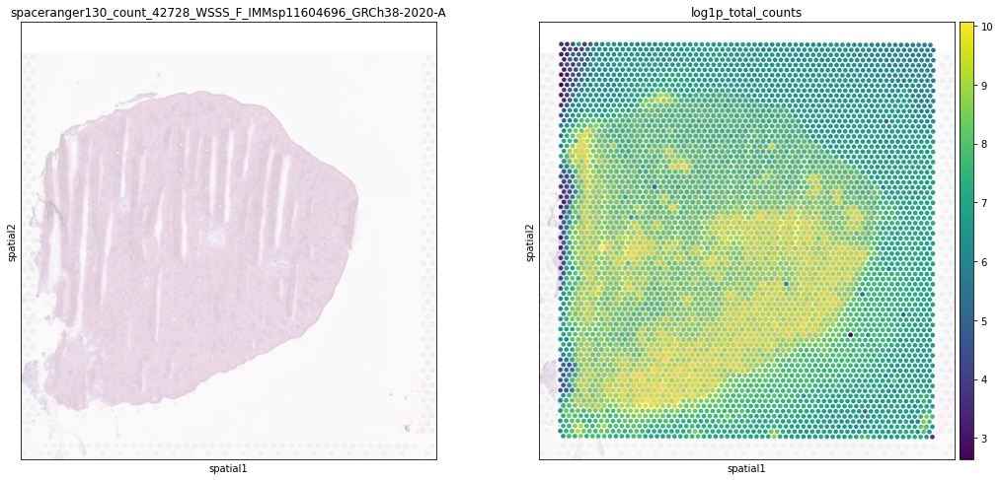

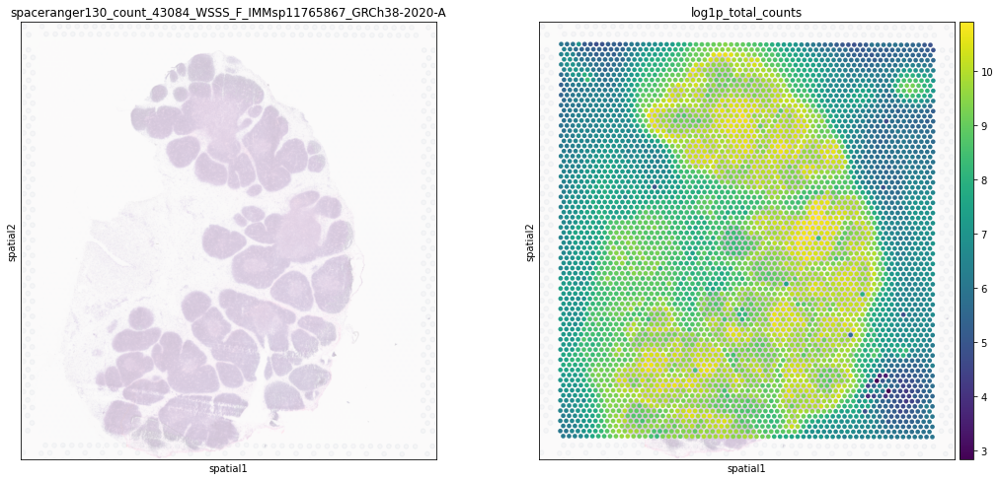

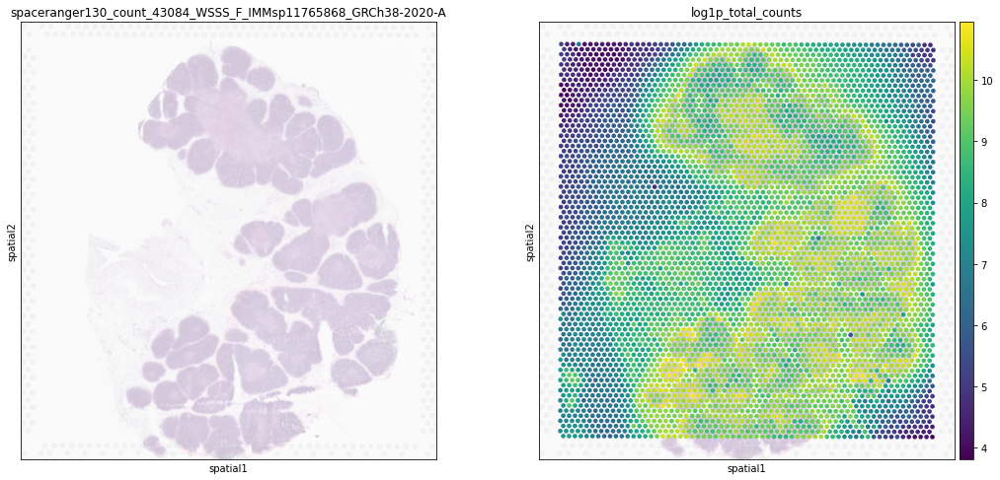

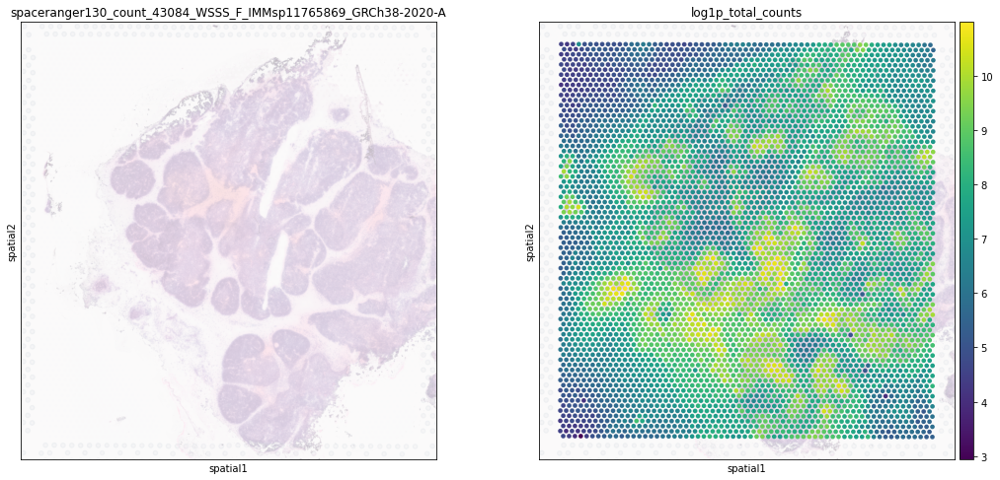

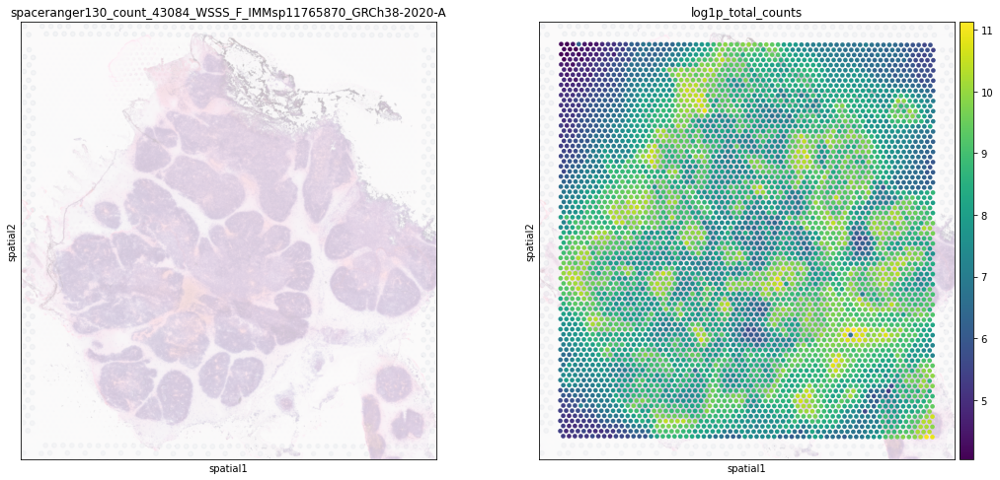

In [37]:
plt.rcParams['figure.figsize'] = (8,8)
for s in slides:
#     s.obs['is_tissue'] = s.obs['in_tissue'].copy()
    sc.pl.spatial(s, color=[None, 'log1p_total_counts'], size=1.2, alpha_img=0.3, title=[s.obs['sample'].unique()[0], 'log1p_total_counts'])
#     s.obs['in_tissue'] = s.obs['is_tissue'].copy()

In [103]:
# Combine anndata objects together
adata = slides[0].concatenate(
    slides[1:],
    batch_key="sample",
    uns_merge="unique",
    batch_categories=sample_data['Sanger_ID'].values,
    index_unique=None
)

# Add sample annotations
adata.obs[sample_data.columns] = sample_data.reindex(adata.obs['sample']).values
#######################

In [104]:
# swap_samples = ["WSSS_F_IMMsp10864177", "WSSS_F_IMMsp10864178", "WSSS_F_IMMsp10864180",'WSSS_F_IMMsp9838717'
# #                 'WSSS_F_IMMsp11604693', 'WSSS_F_IMMsp11604695', 'WSSS_F_IMMsp11604696'
#                ]

# for s in swap_samples:
#     a = select_slide(adata, s)
#     fig, axs = plt.subplots(1,3, figsize=(12,4))
#     sc.pl.spatial(a, title=s, show=False, ax=axs[0])
#     sc.pl.spatial(a, color=['in_tissue'], alpha_img=0, ax=axs[1], show=False)
#     sc.pl.spatial(a, color=['log1p_total_counts'], alpha_img=0, ax=axs[2], show=False)
# #     fig.savefig(f'/home/jovyan/{s}_show_swap.png')

# for s in swap_samples:
#     a = select_slide(adata, s)
#     a.var_names = a.var['SYMBOL'].copy()
#     sc.pp.normalize_per_cell(a, counts_per_cell_after=10e04)
#     sc.pp.log1p(a)
#     fig, axs = plt.subplots(1,3, figsize=(16,4))
#     sc.pl.spatial(a, title=s, show=False, ax=axs[0])
#     sc.pl.spatial(a, color=['in_tissue'], alpha_img=0, ax=axs[1], show=False)
#     sc.pl.spatial(a, color=['AFP'], alpha_img=0, ax=axs[2], show=False)
#     fig.show()

In [105]:
# Select tissue spots
adata = adata[adata.obs['in_tissue'] == 1.0, :]
# adata = adata[~adata.obs['sample'].isin(['WSSS_F_IMMsp10864177', 'WSSS_F_IMMsp10864178']), :].copy()
adata.obs['sample'] = adata.obs['sample'].astype(str)
sample_data = sample_data[~sample_data.index.isin(['WSSS_F_IMMsp10864180', 'WSSS_F_IMMsp10864178'])]
# # Select thymus data
# adata = adata[adata.obs['Organ'].isin(['THY']), :]
sample_data


Trying to set attribute `.obs` of view, copying.


,Unnamed: 0,Sanger_ID,img_id,EXP_id,Organ,Fetal_id,SN,Visium_Area_id,Age_PCW,Digestion time,Data_dir,file,published,paths,sample_id
WSSS_F_IMMsp9838712,0,WSSS_F_IMMsp9838712,F121_LP1_4LIV,LP1,liver,F121,V10U29-031,A1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838712,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...,spaceranger130_count_36654_WSSS_F_IMMsp9838712...
WSSS_F_IMMsp9838709,1,WSSS_F_IMMsp9838709,F117_LP1_1SPL,LP1,spleen,F117,V10U29-031,D1,11,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838709,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...,spaceranger130_count_36654_WSSS_F_IMMsp9838709...
WSSS_F_IMMsp9838710,2,WSSS_F_IMMsp9838710,F121_LP1_2SPL,LP1,spleen,F121,V10U29-031,C1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838710,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...,spaceranger130_count_36654_WSSS_F_IMMsp9838710...
WSSS_F_IMMsp9838711,3,WSSS_F_IMMsp9838711,F121_LP1_3THY,LP1,thymus,F121,V10U29-031,B1,18,24.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838711,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...,spaceranger130_count_36654_WSSS_F_IMMsp9838711...
WSSS_F_IMMsp9838717,4,WSSS_F_IMMsp9838717,F121_LP2_4LIV,LP2,liver,F121,V10U29-029,A1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838717,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...,spaceranger130_count_36811_WSSS_F_IMMsp9838717...
WSSS_F_IMMsp9838714,5,WSSS_F_IMMsp9838714,F117_LP2_1SPL,LP2,spleen,F117,V10U29-029,D1,11,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838714,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...,spaceranger130_count_36811_WSSS_F_IMMsp9838714...
WSSS_F_IMMsp9838715,6,WSSS_F_IMMsp9838715,F121_LP2_2SPL,LP2,spleen,F121,V10U29-029,C1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838715,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...,spaceranger130_count_36811_WSSS_F_IMMsp9838715...
WSSS_F_IMMsp9838716,7,WSSS_F_IMMsp9838716,F121_LP2_3THY,LP2,thymus,F121,V10U29-029,B1,18,24.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp9838716,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...,spaceranger130_count_36811_WSSS_F_IMMsp9838716...
WSSS_F_IMMsp10864177,10,WSSS_F_IMMsp10864177,F122_LP3_4LIV,LP3,liver,F122,V10U29-028,A1,15,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp10864177,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...,WSSS_F_IMMsp10864177
WSSS_F_IMMsp10864184,11,WSSS_F_IMMsp10864184,F136_LP4_1LIV,LP4,liver,F136,V10U29-030,D1,18,18.0,/nfs/team205/ig7/work_backups/backup_210306/pr...,WSSS_F_IMMsp10864184,True,/nfs/team205/ed6/data/Fetal_immune/spaceranger...,spaceranger130_count_WSSS_F_IMMsp10864184_GRCh...


<div class="alert alert-block alert-danger">
<b>Note!</b>
Mitochondia-encoded genes (gene names start with prefix mt- or MT-) are irrelevant for spatial mapping because their expression represents technical artifacts in the single cell and nucleus data rather than biological abundance of mitochondria. Yet these genes compose 15-40% of mRNA in each location. Hence, to avoid mapping artifacts we strongly recommend removing mitochondrial genes.
</div>

In [89]:
# mitochondria-encoded (MT) genes should be removed for spatial mapping
adata.obsm['mt'] = adata[:, adata.var['mt'].values].X.toarray()
adata = adata[:, ~adata.var['mt'].values].copy()

<AxesSubplot:xlabel='Age_PCW', ylabel='Organ'>

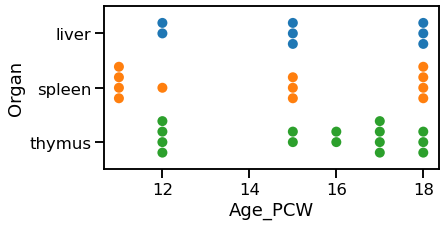

In [90]:
metadata_df = adata.obs[['sample', 'Organ', "Age_PCW"]].drop_duplicates()
sns.set_context("talk")
plt.rcParams['figure.figsize'] = [6,3]
sns.swarmplot(data=metadata_df, y='Organ', x='Age_PCW', size=10)

In [42]:
adata

AnnData object with n_obs × n_vars = 76169 × 36601
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'Unnamed: 0', 'Sanger_ID', 'img_id', 'EXP_id', 'Organ', 'Fetal_id', 'SN', 'Visium_Area_id', 'Age_PCW', 'Digestion time', 'Data_dir', 'file', 'published', 'paths', 'sample_id'
    var: 'feature_types', 'genome', 'SYMBOL', 'mt', 'n_cells_by_counts-WSSS_F_IMMsp10864177', 'mean_counts-WSSS_F_IMMsp10864177', 'log1p_mean_counts-WSSS_F_IMMsp10864177', 'pct_dropout_by_counts-WSSS_F_IMMsp10864177', 'total_counts-WSSS_F_IMMsp10864177', 'log1p_total_counts-WSSS_F_IMMsp10864177', 'n_cells_by_counts-WSSS_F_IMMsp10864178', 'mean_counts-WSSS_F_IMMsp10864178', 'log1p_mean_counts-WSSS_F_IMMsp10864178', 'pct_dropout_by_counts-WSSS_F_IMMsp10864178', 'total_counts-WSSS_F_IMMsp108641

### QC metrics - thymus

Now let's look at QC: total number of counts and total number of genes per location across Visium experiments.

In [544]:
adata_pp = adata.copy()
adata_pp.var_names = adata_pp.var['SYMBOL'].values

In [545]:
sc.pp.normalize_per_cell(adata_pp)
sc.pp.log1p(adata_pp)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [ ]:

plt.rcParams['figure.figsize'] = [12,12]
min_counts = 500
g_cortex = 'ARPP21'
g_medulla = 'AIRE'
for s in sample_data.index[sample_data['Organ'] == 'thymus']:
    with suppress_stdout_stderr():
        slide = select_slide(adata_pp, s, select_spatial=True)
    slide = slide[slide.obs['total_counts'] > min_counts].copy()
    sc.pl.spatial(slide, color=[None, "total_counts", g_cortex, g_medulla], alpha_img=0.7, title=[s, 'total_counts', g_cortex, g_medulla], size=1.2)

Notes:
- 91 and 92 seem not salvageable
- doubious about 86

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'sample' as categorical
... storing 'Sanger_ID' as categorical
... storing 'img_id' as categorical
... storing 'EXP_id' as categorical
... storing 'Organ' as categorical
... storing 'Fetal_id' as categorical
... storing 'SN' as categorical
... storing 'Visium_Area_id' as categorical
... storing 'paths' as categorical
... storing 'sample_id' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'sample' as categorical
... storing 'Sanger_ID' as categorical
... storing 'img_id' as categorical
... storing 'EXP_id' as categorical
... storing 'Organ' as categorical
... storing 'Fetal_id' as categorical
... storing 'SN' as categorical
... storing 'Visium_Area_id' as categorical
... storing 'paths' as categorical
... storing 'sampl

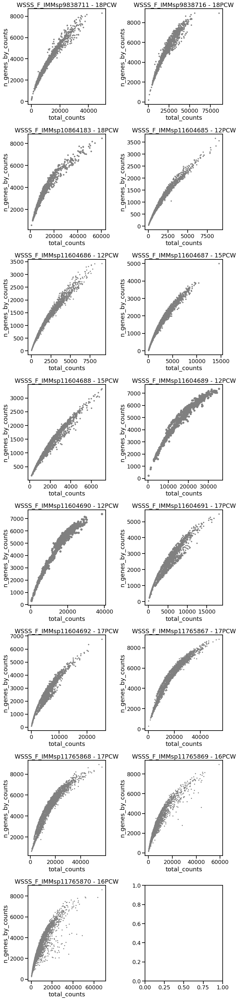

In [547]:
org='thymus'
n_samples =len(sample_data.index[sample_data['Organ'] == org])

fig, axs = plt.subplots(int(n_samples/2)+1, 2, figsize=(10, 3*n_samples-3))
row=0
for i,s in enumerate(sample_data.index[sample_data['Organ'] == org]):
    with suppress_stdout_stderr():
        slide = select_slide(adata_pp, s, select_spatial=True)
    col = i%2
    sc.pl.scatter(slide, 'total_counts', 'n_genes_by_counts', title=f'{s} - {slide.obs["Age_PCW"][0]}PCW', ax=axs[row,col], show=False)
    row = row+col
plt.tight_layout()

### QC metrics - spleen

In [ ]:
plt.rcParams['figure.figsize'] = [12,12]
min_counts = 500
spl_marker_1 = 'CDH5'
spl_marker_2 = 'PDGFRB'
for s in sample_data.index[sample_data['Organ'] == 'spleen']:
    with suppress_stdout_stderr():
        slide = select_slide(adata_pp, s, select_spatial=True)
    slide = slide[slide.obs['total_counts'] > min_counts].copy()
    sc.pl.spatial(slide, color=[None, "total_counts", spl_marker_1, spl_marker_2], alpha_img=0.7, title=[s, 'total_counts', spl_marker_1, spl_marker_2], size=1.2)

Notes:
- 91 and 92 seem not salvageable
- doubious about 86

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'sample' as categorical
... storing 'Sanger_ID' as categorical
... storing 'img_id' as categorical
... storing 'EXP_id' as categorical
... storing 'Organ' as categorical
... storing 'Fetal_id' as categorical
... storing 'SN' as categorical
... storing 'Visium_Area_id' as categorical
... storing 'paths' as categorical
... storing 'sample_id' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'sample' as categorical
... storing 'Sanger_ID' as categorical
... storing 'img_id' as categorical
... storing 'EXP_id' as categorical
... storing 'Organ' as categorical
... storing 'Fetal_id' as categorical
... storing 'SN' as categorical
... storing 'Visium_Area_id' as categorical
... storing 'paths' as categorical
... storing 'sampl

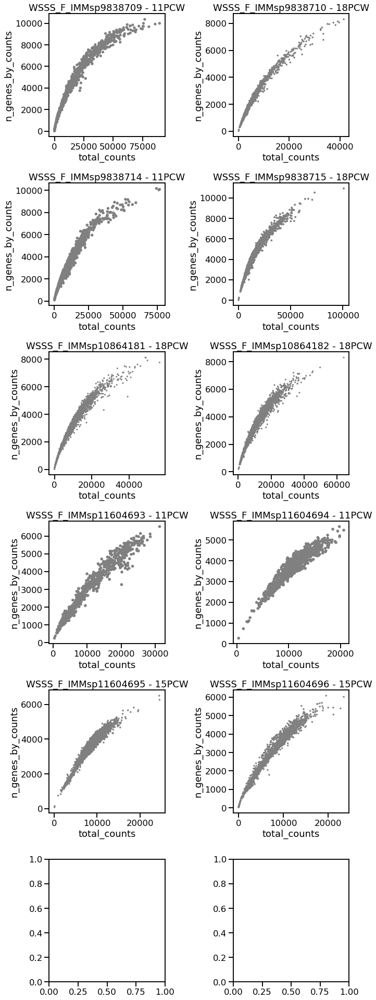

In [549]:
org='spleen'
n_samples =len(sample_data.index[sample_data['Organ'] == org])

fig, axs = plt.subplots(int(n_samples/2)+1, 2, figsize=(10, 3*n_samples-3))
row=0
for i,s in enumerate(sample_data.index[sample_data['Organ'] == org]):
    with suppress_stdout_stderr():
        slide = select_slide(adata_pp, s, select_spatial=True)
    col = i%2
    sc.pl.scatter(slide, 'total_counts', 'n_genes_by_counts', title=f'{s} - {slide.obs["Age_PCW"][0]}PCW', ax=axs[row,col], show=False)
    row = row+col
plt.tight_layout()

### QC metrics - liver

In [ ]:
plt.rcParams['figure.figsize'] = [12,12]
min_counts = 500
li_marker_1 = 'CDH5'
li_marker_2 = 'APOA1'
for s in sample_data.index[sample_data['Organ'] == 'liver']:
    with suppress_stdout_stderr():
        slide = select_slide(adata_pp, s, select_spatial=True)
    slide = slide[slide.obs['total_counts'] > min_counts].copy()
    sc.pl.spatial(slide, color=[None, "total_counts", li_marker_1, li_marker_2], alpha_img=0.7, title=[s, 'total_counts', li_marker_1, li_marker_2], size=1.2)

Notes:
- 91 and 92 seem not salvageable
- doubious about 86

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'sample' as categorical
... storing 'Sanger_ID' as categorical
... storing 'img_id' as categorical
... storing 'EXP_id' as categorical
... storing 'Organ' as categorical
... storing 'Fetal_id' as categorical
... storing 'SN' as categorical
... storing 'Visium_Area_id' as categorical
... storing 'paths' as categorical
... storing 'sample_id' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'sample' as categorical
... storing 'Sanger_ID' as categorical
... storing 'img_id' as categorical
... storing 'EXP_id' as categorical
... storing 'Organ' as categorical
... storing 'Fetal_id' as categorical
... storing 'SN' as categorical
... storing 'Visium_Area_id' as categorical
... storing 'paths' as categorical
... storing 'sampl

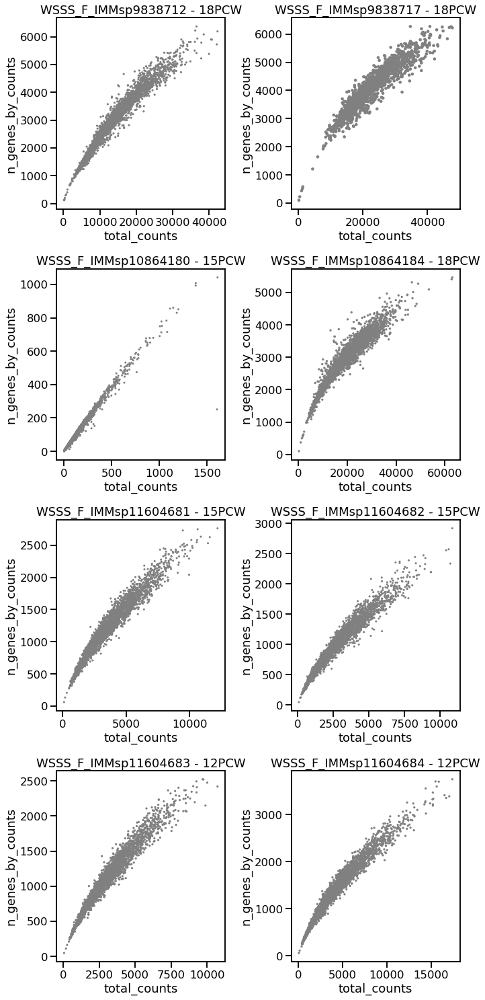

In [551]:
org='liver'
n_samples =len(sample_data.index[sample_data['Organ'] == org])

fig, axs = plt.subplots(int(n_samples/2), 2, figsize=(10, 3*n_samples-3))
row=0
for i,s in enumerate(sample_data.index[sample_data['Organ'] == org]):
    with suppress_stdout_stderr():
        slide = select_slide(adata_pp, s, select_spatial=True)
    col = i%2
    sc.pl.scatter(slide, 'total_counts', 'n_genes_by_counts', title=f'{s} - {slide.obs["Age_PCW"][0]}PCW', ax=axs[row,col], show=False)
    row = row+col
plt.tight_layout()

### Flag low quality samples

In [76]:
low_q = ['WSSS_F_IMMsp11604691', 'WSSS_F_IMMsp11604692', 'WSSS_F_IMMsp11604686', 'WSSS_F_IMMsp10864180', 'WSSS_F_IMMsp10864178']

<AxesSubplot:xlabel='Age_PCW', ylabel='Organ'>

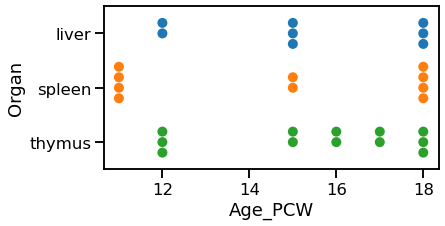

In [77]:
sns.set_context("talk")
plt.rcParams['figure.figsize'] = [6,3]
sns.swarmplot(data=metadata_df[~metadata_df['sample'].isin(low_q)], y='Organ', x='Age_PCW', size=10)

## Prep datasets for cell2location analysis

In [115]:
## Exclude low quality samples
adata = adata[~adata.obs['sample'].isin(low_q)].copy()

## Filter spots with low counts
min_counts = 500
adata = adata[adata.obs['total_counts'] > min_counts].copy()

## Split by organ
def _filter_organ(org):
    adata_org = adata[adata.obs['Organ'] == org].copy()
    org_samples = adata_org.obs.sample_id.unique()
    adata_org.uns['spatial'] = {s:adata_org.uns['spatial'][s] for s in org_samples if s in adata_org.uns['spatial'].keys()}
    adata_org.var = adata_org.var[['feature_types', 'genome', 'SYMBOL', 'mt']].copy()
    return(adata_org)

In [116]:
adata_LI = _filter_organ(org='liver')
adata_TH = _filter_organ(org='thymus')
adata_SP = _filter_organ(org='spleen')

In [117]:
## Save
outdir = '/nfs/team205/ed6/data/Fetal_immune/c2l_visium/'
if not os.path.exists(outdir):
    os.mkdir(outdir)
    

In [118]:
adata_LI.write_h5ad(outdir + 'fetal_immune_spatial.liver.h5ad')
adata_TH.write_h5ad(outdir + 'fetal_immune_spatial.thymus.h5ad')
adata_SP.write_h5ad(outdir + 'fetal_immune_spatial.spleen.h5ad')

... storing 'sample' as categorical
... storing 'Sanger_ID' as categorical
... storing 'img_id' as categorical
... storing 'EXP_id' as categorical
... storing 'Organ' as categorical
... storing 'Fetal_id' as categorical
... storing 'SN' as categorical
... storing 'Visium_Area_id' as categorical
... storing 'Data_dir' as categorical
... storing 'file' as categorical
... storing 'paths' as categorical
... storing 'sample_id' as categorical
... storing 'sample' as categorical
... storing 'Sanger_ID' as categorical
... storing 'img_id' as categorical
... storing 'EXP_id' as categorical
... storing 'Organ' as categorical
... storing 'Fetal_id' as categorical
... storing 'SN' as categorical
... storing 'Visium_Area_id' as categorical
... storing 'Data_dir' as categorical
... storing 'file' as categorical
... storing 'paths' as categorical
... storing 'sample_id' as categorical
... storing 'sample' as categorical
... storing 'Sanger_ID' as categorical
... storing 'img_id' as categorical
... s

In [119]:
batch1_samples_sp = ['WSSS_F_IMMsp9838710', 'WSSS_F_IMMsp9838715', 'WSSS_F_IMMsp10864181', 'WSSS_F_IMMsp10864182']
adata_SP = adata_SP[adata_SP.obs['sample'].isin(batch1_samples_sp)].copy()
adata_SP.obs["Organ"] = 'SP'

In [120]:
adata_SP.write_h5ad(outdir + 'fetal_immune_spatial.batch1.spleen.h5ad')

... storing 'Organ' as categorical


In [121]:
batch1_samples_li = sample_data[(sample_data.Organ == 'liver') & (sample_data.published)]['Sanger_ID'].values
adata_LI = adata_LI[adata_LI.obs['sample'].isin(batch1_samples_li)].copy()
adata_LI.obs["Organ"] = 'LI'
# adata_LI.write_h5ad(outdir + 'fetal_immune_spatial.batch1.liver.h5ad')

In [123]:
adata_LI.write_h5ad(outdir + 'fetal_immune_spatial.batch1.liver.h5ad')
outdir + 'fetal_immune_spatial.batch1.liver.h5ad'

... storing 'Organ' as categorical


'/nfs/team205/ed6/data/Fetal_immune/c2l_visium/fetal_immune_spatial.batch1.liver.h5ad'

In [122]:
adata_LI.obs['sample'].unique()

['WSSS_F_IMMsp9838712', 'WSSS_F_IMMsp9838717', 'WSSS_F_IMMsp10864184']
Categories (3, object): ['WSSS_F_IMMsp9838712', 'WSSS_F_IMMsp9838717', 'WSSS_F_IMMsp10864184']

## Prep single-cell reference for cell2location analysis

We try two training regimes:
1. By organ, all cells from the organ
2. By organ and age, separate deconvolution and training for early time points and late time points

While splitting by age the reference, we will train the deconvolution model on all slides from the same organ simoultaneously to allow better estimation of batch effects.

Reference datasets where generated running

```
python c2l_mapping/prep_c2l_reference.py --subset_organ SP 
python c2l_mapping/prep_c2l_reference.py --subset_organ SP --max_age 13
python c2l_mapping/prep_c2l_reference.py --subset_organ SP --min_age 14
python c2l_mapping/prep_c2l_reference.py --subset_organ LI
python c2l_mapping/prep_c2l_reference.py --subset_organ LI --max_age 13
python c2l_mapping/prep_c2l_reference.py --subset_organ LI --min_age 14
python c2l_mapping/prep_c2l_reference.py --subset_organ TH --add_TECs True --keep_fetal_TECs True
python c2l_mapping/prep_c2l_reference.py --subset_organ TH --add_TECs True --keep_fetal_TECs True --max_age 13
python c2l_mapping/prep_c2l_reference.py --subset_organ TH --add_TECs True --keep_fetal_TECs True --min_age 14
```

In [9]:
data_dir="/nfs/team205/ed6/data/Fetal_immune/"
timestamp="20210429"

# Make folder to save outputs
outdir = data_dir + "c2l_scRNA_references/"
if not os.path.exists(outdir):
    os.mkdir(outdir)

### Load reference data
adata = sc.read_h5ad(data_dir + 'PAN.A01.v01.entire_data_raw_count.{t}.h5ad'.format(t=timestamp))
adata.var_names_make_unique()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [10]:
## Filter maternal contaminants
mat_barcodes = pd.read_csv("../../../metadata/souporcell_results/maternal_barcodes.csv", index_col=0)
mat_barcodes["x"] = pd.Series([x.split("-1")[0] for x in mat_barcodes['x']])
adata = adata[~adata.obs_names.isin(mat_barcodes["x"])]

## Read annotation groupings
import json
with open('../../../metadata/anno_groups.json', 'r') as json_file:
    anno_groups_dict = json.load(json_file)

anno_obs = pd.read_csv(data_dir + "PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv", index_col=0)
adata = adata[adata.obs_names.isin(anno_obs.index)].copy()
adata.obs = anno_obs.loc[adata.obs_names].copy()
del anno_obs

## Restrict to organs profiled with visium
adata = adata[adata.obs["organ"].isin(["TH", "SP", "LI", 'GU'])].copy()
import gc
gc.collect()

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (6) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


2590

In [11]:
## Tissue specific annotations
adata.obs["anno_c2l"] = adata.obs["anno_lvl_2_final_clean"].copy()
# Thymus
TH_annotations = pd.read_csv('/home/jovyan/mount/gdrive/Pan_fetal/annotations/original_files/fetal_thymus_anno.csv')
anno_c2l_th = adata.obs[adata.obs['organ'] == "TH"].copy()
anno_c2l_th['anno_organ'] = np.nan
anno_c2l_th.loc[TH_annotations['index'][TH_annotations['index'].isin(anno_c2l_th.index)],'anno_organ'] = TH_annotations[TH_annotations['index'].isin(anno_c2l_th.index)]['Anno_level_5'].values

rename_cells = anno_c2l_th.index[anno_c2l_th['anno_lvl_2_final_clean'] == "KERATINOCYTE"]
rename_label = anno_c2l_th.anno_organ[anno_c2l_th['anno_lvl_2_final_clean'] == "KERATINOCYTE"].values

adata.obs.loc[rename_cells,"anno_c2l"] = rename_label

In [619]:
th_adata_anno = sc.read_h5ad(th_atlas_anno, backed='r')


KeyError: "Unable to open object (file read failed: time = Fri Feb 25 08:00:36 2022\n, filename = '/lustre/scratch117/cellgen/team205/cs42/jovyan_25082021/thymusatlas/HTA08.v01.A05.Science_human_fig1.h5ad', file descriptor = 54, errno = 5, error message = 'Input/output error', buf = 0x5603eb28bf60, total read size = 512, bytes this sub-read = 512, bytes actually read = 18446744073709551615, offset = 0)"

In [614]:
## Add additional TECs
# if add_tecs:
th_atlas = '/lustre/scratch117/cellgen/team205/cs42/jovyan_25082021/thymusatlas/HTA07.A01.v02.entire_data_raw_count.h5ad'
th_atlas_anno = '/lustre/scratch117/cellgen/team205/cs42/jovyan_25082021/thymusatlas/HTA08.v01.A05.Science_human_fig1.h5ad'
# get TECs
th_adata = sc.read_h5ad(th_atlas)
th_adata_anno = sc.read_h5ad(th_atlas_anno, backed='r')
tec_labels = [x for x in th_adata_anno.obs['Anno_level_fig1'].unique() if "TEC" in x]
tec_cells = th_adata_anno.obs_names[th_adata_anno.obs['Anno_level_fig1'].isin(tec_labels)]
if keep_fetal_TECs:
    keep_ages = [x for x in th_adata_anno.obs['Age'].unique() if x.endswith('w')]
    tec_cells = th_adata_anno.obs_names[(th_adata_anno.obs['Anno_level_fig1'].isin(tec_labels)) & (th_adata_anno.obs['Age'].isin(keep_ages))]
tec_adata = th_adata[tec_cells[~tec_cells.isin(anno_c2l_th.index)]].copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


KeyError: "Unable to open object (file read failed: time = Thu Feb 24 19:54:28 2022\n, filename = '/lustre/scratch117/cellgen/team205/cs42/jovyan_25082021/thymusatlas/HTA08.v01.A05.Science_human_fig1.h5ad', file descriptor = 54, errno = 5, error message = 'Input/output error', buf = 0x56049bd4b5c0, total read size = 512, bytes this sub-read = 512, bytes actually read = 18446744073709551615, offset = 0)"

In [12]:
ref_sc_dir = '/nfs/team205/ed6/data/Fetal_immune/c2l_scRNA_references/'
ref_data_files = [x for x in os.listdir(ref_sc_dir) if x.startswith("PAN") and "v2" in x]

In [112]:
[f for f in ref_data_files if org in f]

['PAN.A01.v01.c2l_reference.v2.subsetLI.minAge14.exclude_lowQ.h5ad',
 'PAN.A01.v01.c2l_reference.v2.subsetLI.maxAge13.exclude_lowQ.h5ad',
 'PAN.A01.v01.c2l_reference.v2.subsetLI.exclude_lowQ.h5ad']

In [136]:
org = 'TH'
ref_adata = sc.read_h5ad(ref_sc_dir + 'PAN.A01.v01.c2l_reference.v2.subsetTH.exclude_lowQ.addTECs.keep_fetal_TECs.h5ad')

In [137]:
ref_adata

AnnData object with n_obs × n_vars = 113753 × 45068
    obs: 'method', 'donor', 'Sample.lanes', 'anno_c2l', 'organ', 'age'
    var: 'GeneID-0', 'GeneName-0', 'GeneID-1', 'GeneName-1'

In [138]:
if org=='TH':
    keep_vars = ref_adata.var_names[ref_adata.var['GeneID-0'].astype('str') == ref_adata.var['GeneID-1'].astype('str')]
    ref_adata = ref_adata[:,keep_vars].copy()
    ref_adata.var = ref_adata.var[['GeneID-0', 'GeneName-0']].copy()
    ref_adata.var.columns = ['GeneID', 'GeneName']

In [139]:
## Remove empty genes
keep_genes = np.array(ref_adata.X.sum(0) > 0).ravel()
ref_adata = ref_adata[:,keep_genes].copy()

In [142]:
ref_adata

AnnData object with n_obs × n_vars = 113753 × 20594
    obs: 'method', 'donor', 'Sample.lanes', 'anno_c2l', 'organ', 'age'
    var: 'GeneID', 'GeneName'

In [141]:
ref_adata.write_h5ad(ref_sc_dir + 'PAN.A01.v01.c2l_reference.v2.subsetTH.exclude_lowQ.addTECs.keep_fetal_TECs.h5ad')

In [107]:
org = 'LI'
ref_adata_early = sc.read_h5ad(ref_sc_dir + [f for f in ref_data_files if org in f and 'maxAge' in f][0])
ref_adata_late = sc.read_h5ad(ref_sc_dir + [f for f in ref_data_files if org in f and 'minAge' in f][0])

# ## Keep matching genes 
# keep_vars = ref_adata_late.var_names[ref_adata_late.var['GeneID-0'].astype('str') == ref_adata_late.var['GeneID-1'].astype('str')]
# ref_adata_late = ref_adata_late[:,keep_vars].copy()
# ref_adata_late.var = ref_adata_late.var[['GeneID-0', 'GeneName-0']].copy()
# ref_adata_late.var.columns = ['GeneID', 'GeneName']

# keep_vars = ref_adata_early.var_names[ref_adata_early.var['GeneID-0'].astype('str') == ref_adata_early.var['GeneID-1'].astype('str')]
# ref_adata_early = ref_adata_early[:,keep_vars].copy()
# ref_adata_early.var = ref_adata_early.var[['GeneID-0', 'GeneName-0']].copy()
# ref_adata_early.var.columns = ['GeneID', 'GeneName']

## Remove empty genes
keep_genes = np.array(ref_adata_late.X.sum(0) > 0).ravel()
ref_adata_late = ref_adata_late[:,keep_genes].copy()
keep_genes = np.array(ref_adata_early.X.sum(0) > 0).ravel()
ref_adata_early = ref_adata_early[:,keep_genes].copy()

ref_adata_early.write_h5ad(ref_sc_dir + [f for f in ref_data_files if org in f and 'maxAge' in f][0])
ref_adata_late.write_h5ad(ref_sc_dir + [f for f in ref_data_files if org in f and 'minAge' in f][0])

In [108]:
full_df = pd.DataFrame()
for org in ['SP', "TH", "LI"]:
    ref_adata_early = sc.read_h5ad(ref_sc_dir + [f for f in ref_data_files if org in f and 'maxAge' in f][0])
    ref_adata_late = sc.read_h5ad(ref_sc_dir + [f for f in ref_data_files if org in f and 'minAge' in f][0])
    ref_adata_early
    df = ref_adata_late.obs[['age','anno_c2l']].groupby(['age','anno_c2l']).size().reset_index()
    df['n_cells'] = df[0].copy()
    df['dataset'] = f'{org}_late'

    df2 = ref_adata_early.obs[['age','anno_c2l']].groupby(['age','anno_c2l']).size().reset_index()
    df2['n_cells'] = df2[0].copy()
    df2['dataset'] = f'{org}_early'

    df = pd.concat([df, df2])
    full_df = pd.concat([full_df, df])


── Column specification ────────────────────────────────────────────────────────
cols(
  organ = col_character(),
  color = col_character()
)

`summarise()` has grouped output by 'anno_c2l', 'organ'. You can override using the `.groups` argument.


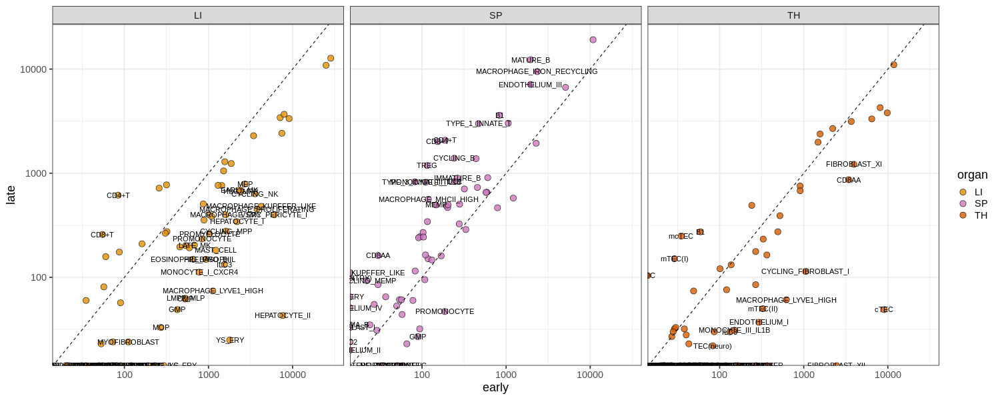

In [480]:
%%R -i full_df -w 1500 -h 600
org_colors <- read_csv('../../../metadata/organ_colors.csv')
org_palette <- setNames( org_colors$color, org_colors$organ)

pl_df <- full_df %>%
    separate(dataset, into=c("organ", 'time'), sep='_') %>%
    group_by(anno_c2l, organ, time) %>%
    summarise(n_cells_tot=sum(n_cells)) %>%
    ungroup() %>%
    pivot_wider(id_cols=c(anno_c2l, organ), names_from=time, values_from=n_cells_tot) %>%
    mutate(early=ifelse(is.na(early), 0, early)) %>%
    mutate(late=ifelse(is.na(late), 0, late)) 
    
pl_df %>%
    ggplot(aes(early, late)) +
    geom_point(size=4, aes(fill=organ),shape=21, alpha=0.8) +
    geom_text(
        data=. %>% filter((log10(late) > log10(early) + 0.5) | (log10(early) > log10(late) + 0.5) | 
                          (late <= 0) | (early <= 0)
                         ),
                             aes(label=anno_c2l), segment.size= 0.2) +
    scale_x_log10() +
    scale_y_log10() +
    geom_abline(linetype=2) +
    theme_bw(base_size=18) +
    scale_fill_manual(values=org_palette) +
    facet_wrap(organ~.) +
    ggsave(paste0(figdir, 'single_cell_reference_scatter.pdf'), height=6, width=15)

`summarise()` has grouped output by 'anno_c2l', 'organ'. You can override using the `.groups` argument.
`summarise()` has grouped output by 'anno_c2l', 'organ'. You can override using the `.groups` argument.
`summarise()` has grouped output by 'anno_c2l', 'organ'. You can override using the `.groups` argument.


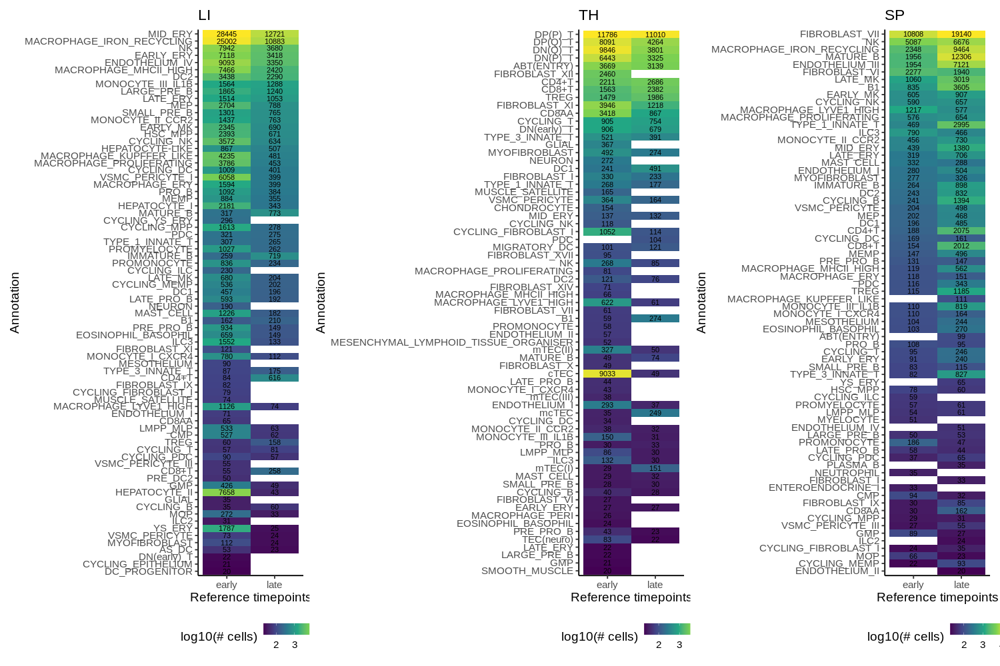

In [481]:
%%R -w 1500 -h 1000 -i figdir
pl_ls <- lapply( c("LI", "TH", "SP"), function(org){
 full_df %>%
    separate(dataset, into=c("organ", 'time'), sep='_') %>%
    filter(organ==org) %>%
    group_by(anno_c2l, organ, time) %>%
    summarise(n_cells_tot=sum(n_cells)) %>%
    ungroup() %>%
    arrange(n_cells_tot) %>%
    mutate(anno_c2l= factor(anno_c2l, levels=unique(anno_c2l))) %>%
    ungroup() %>%
    ggplot(aes(time, anno_c2l)) +
    geom_tile(aes(fill=log10(n_cells_tot))) +
    scale_fill_viridis_c(name='log10(# cells)') +
    theme_classic(base_size=19) +
    geom_text(aes(label=n_cells_tot)) +
    ylab("Annotation") +
    xlab("Reference timepoints") +
    ggtitle(org) +
    theme(legend.position='bottom')
    })

wrap_plots(pl_ls, ncols=3) +
ggsave(paste0(figdir, 'single_cell_reference_cell_no.pdf'), height=14, width=18)